# Interpolation of precipitation extremes on a large domain toward IDF curve construction at unmonitored locations

Jonathan Jalbert$^1$, Christian Genest$^2$ and Luc Perreault$^3$

$^1$Polytechnique Montréal  
$^2$McGill University  
$^3$Institut de recherche d'Hydro-Québec  


This program goes along with the paper of Jalbert *et al.* (2022) which describes how extreme precipitation of several durations can be interpolated to compute IDF curves on a large, sparse domain. In this code, sparse precipitation extremes for a given duration are interpolated on a regular lattice. The lattice is the one where the spatial covariate lies. The cross-validation program is provided in another file.

Jalbert J., Genest, C. and Perreault L, (2022). Interpolation of precipitation extremes on a large domain toward IDF curve construction at unmonitored locations. *Journal of Agricultural, Biological, and Environmental Statistics*, To appear.


In [1]:
using GMRF, Extremes
using CSV, DataFrames, Distributions, LinearAlgebra, SparseArrays, Random, StatsBase
using Mamba, ProgressMeter
using Gadfly
import Plots
include("functions.jl")

cvmcriterion (generic function with 2 methods)

In [2]:
DURATION = "24 h"
PROVINCES = ["NB", "NL", "NS", "ON", "PE", "QC"]

ORDER = 1


NITER = 215000
WARMUP = 15000
THIN = 20

# NITER = 5000
# WARMUP = 2000
# THIN = 5

STEPSIZE = Dict(:u => .1, :v => .15, :ξ => .02)

Dict{Symbol, Float64} with 3 entries:
  :ξ => 0.02
  :v => 0.15
  :u => 0.1

# 1. Data loading and preparation

The covariate are available on a regular lattice covering the northeastern part of North America through 90,000 grid cells. After croping the grid to a domain centered on Eastern Canada (48,694 grid cells), the available weather stations (at most 329 depending on the precipitation duration) are loaded and located on the corresponding grid cells. 

The steps of data preparation are as follows:
1. Load and crop the gridded covariate.
2. Load the weather station list and select those that lie in the spatial domain.
3. Remove the stations where no data have been recorded for the considered precipitation duration.
4. Find the grid cell where each station lies.
5. If two or more stations share the same grid cell, on the station with the longest record period is retained.
6. Concatenate the precipitation in an array of arrays enabling different lengths of station record periods.

## 1.1 Loading the gridded spatial covariate

The original domain of the CRCM is cropped to the Eastern Canada part. The covariate is stored in a DataFrame.

In [3]:
crcm = CSV.read("Data/CROQmeanPcp.csv", DataFrame)

lat = reshape(crcm[:,1],300,300)
lon = reshape(crcm[:,2],300,300)
pcp = reshape(crcm[:,3],300,300)

latlim = [60, 253];
lonlim = [20, 270];

lat = lat[latlim[1]:latlim[2],lonlim[1]:lonlim[2]]
lon = lon[latlim[1]:latlim[2],lonlim[1]:lonlim[2]]
pcp = pcp[latlim[1]:latlim[2],lonlim[1]:lonlim[2]]

m₁, m₂ = size(lat)
m = m₁*m₂

griddedCovariate = DataFrame(Lat = vec(lat), Lon = vec(lon), meanPcp = vec(pcp))
first(griddedCovariate,5)

,Lat,Lon,meanPcp
,Float64,Float64,Float64
1,42.4558,-94.9948,2.41792
2,42.5658,-94.9909,2.42233
3,42.6758,-94.987,2.41666
4,42.7857,-94.9832,2.46305
5,42.8957,-94.9792,2.47048


## 1.2 Loading the station list where the IDF curves are available in Canada

Only the stations located in the set PROVINCES are retained.

In [4]:
station_list = CSV.read("Data/_station_list.csv", copycols=true, DataFrame)
filter!(row -> row[:Province] ∈ PROVINCES, station_list)
first(station_list,5)

,Name,Province,ID,Lat,Lon,Elevation
,String63,String3,String7,Float64,Float64,Int64
1,BEECHWOOD,NB,8100512,46.53,-67.67,91
2,BELLEDUNE,NB,8100514,47.9,-65.83,7
3,BOUCTOUCHE CDA CS,NB,8100593,46.43,-64.77,35
4,CHARLO AUTO,NB,8100885,47.98,-66.33,42
5,MIRAMICHI RCS,NB,8100989,47.02,-65.47,33


For each selected station, the data are loaded. Afterward, we verify if the stations have recordings at the duration of interest. If not, the station is removed from the dataset. 

In [5]:
Data = DataFrame(Duration=String[], Pcp=Float64[], Year=Int64[], StationID=String[], StationName=String[])

for i=1:length(station_list[:,:ID])
    df = idf_load(station_list[i,:ID])
    df[!,:StationID] .= station_list[i,:ID]
    df[!,:StationName] .= station_list[i,:Name]
    append!(Data,df)
end

select!(Data,[:StationID, :StationName, :Year, :Duration, :Pcp])
first(Data,5)

,StationID,StationName,Year,Duration,Pcp
,String,String,Int64,String,Float64
1,8100512,BEECHWOOD,1959,5 min,9.7
2,8100512,BEECHWOOD,1960,5 min,5.3
3,8100512,BEECHWOOD,1961,5 min,7.4
4,8100512,BEECHWOOD,1962,5 min,5.6
5,8100512,BEECHWOOD,1963,5 min,3.6


In [6]:
# Verification for the presence of records
filter!(row -> row[:Duration] == DURATION, Data)
first(Data,5)

,StationID,StationName,Year,Duration,Pcp
,String,String,Int64,String,Float64
1,8100512,BEECHWOOD,1959,24 h,118.6
2,8100512,BEECHWOOD,1960,24 h,45.2
3,8100512,BEECHWOOD,1961,24 h,69.3
4,8100512,BEECHWOOD,1962,24 h,56.4
5,8100512,BEECHWOOD,1963,24 h,46.0


## 1.3 Removing the stations where no data have been recorded 

Some stations do not have precipitation records for certain durations. Those stations are removed.

In [7]:
activeStation = unique(Data[:,:StationID])
filter!(row -> row[:ID] ∈ activeStation, station_list)
first(station_list,5)

,Name,Province,ID,Lat,Lon,Elevation
,String63,String3,String7,Float64,Float64,Int64
1,BEECHWOOD,NB,8100512,46.53,-67.67,91
2,BELLEDUNE,NB,8100514,47.9,-65.83,7
3,BOUCTOUCHE CDA CS,NB,8100593,46.43,-64.77,35
4,CHARLO AUTO,NB,8100885,47.98,-66.33,42
5,MIRAMICHI RCS,NB,8100989,47.02,-65.47,33


In [8]:
nrow(station_list)

336

## 1.4 For each active station, finding the grid cell where it lies

For each station location, the nearest grid cell centroid is identified. The grid is the one of the girdded covariate.

In [9]:
stationLocation = collect([station_list[:,:Lat] station_list[:,:Lon]]')
gridCoords = collect([griddedCovariate[:,:Lat] griddedCovariate[:,:Lon]]')

V = nnsearch(gridCoords,stationLocation)
station_list[!,:GridCell] = V
first(station_list,5)

,Name,Province,ID,Lat,Lon,Elevation,GridCell
,String63,String3,String7,Float64,Float64,Int64,Int64
1,BEECHWOOD,NB,8100512,46.53,-67.67,91,32276
2,BELLEDUNE,NB,8100514,47.9,-65.83,7,33455
3,BOUCTOUCHE CDA CS,NB,8100593,46.43,-64.77,35,35580
4,CHARLO AUTO,NB,8100885,47.98,-66.33,42,32873
5,MIRAMICHI RCS,NB,8100989,47.02,-65.47,33,34419


## 1.5 Selecting the station if more than one lie in the same grid cell

If more than one station lie in the same grid cell, keeping the one with the longest period of record.

In [10]:
stationID = String[]

for v in unique(V)
    ind = findall(v.==V)
    if length(ind)==1
        push!(stationID,station_list[ind[1],:ID])
    else
        n = Int64[]
        for i=1:length(ind)
           push!(n, count(Data[:,:StationID].==v))
        end
        pos = argmax(n)
        push!(stationID,station_list[ind[pos],:ID])
    end
end

In [11]:
# Grid cells containing more than one station
df = station_list[nonunique(station_list, :GridCell),:]
unique(df.GridCell)

14-element Vector{Int64}:
 33632
 20197
 18645
 19813
 19619
 19814
 19620
 19621
 28003
 25464
 28002
 28572
 26047
 27434

In [12]:
filter!(row -> row[:ID] ∈ stationID, station_list)
sort!(station_list,:GridCell)
first(station_list,5)

,Name,Province,ID,Lat,Lon,Elevation,GridCell
,String63,String3,String7,Float64,Float64,Int64,Int64
1,KENORA RCS,ON,6034073,49.78,-94.38,412,456
2,RED LAKE A,ON,6016975,51.07,-93.78,385,1050
3,RAWSON LAKE (AUT),ON,6036907,49.67,-93.73,435,1231
4,EAR FALLS (AUT),ON,6012199,50.63,-93.22,362,1628
5,SIOUX LOOKOUT A,ON,6037775,50.12,-91.9,383,3175


In [13]:
nrow(station_list)

315

## 1.6 Storing the observations in an Array of Arrays.

In [14]:
Y = Vector{Float64}[]

# for i=1:size(station_list,1)
for stationID in station_list[:,:ID]
#     stationID = station_list[i,:ID]
    y = Data[Data[:,:StationID].== stationID,:Pcp]
    push!(Y,y)
end

# 2. Latent iGMRF definition

The grid structure for the latent iGMRFs is defined. The set of grid cells where the observations are defined in $S$ is defined and the remaining grid cells are defined in $\bar{S}$. Conditional independant subsets are also defined to improve mcmc performance.

In [15]:
n = length(Y)
m = m₁*m₂

# G = gridstructure_igmrf(m₁,m₂,ORDER);
G = iGMRF(m₁,m₂,ORDER,1).G

V = station_list[:,:GridCell]

condIndIndex = [ findall(in(intersect(G.condIndSubset[j],V)),V) for j=1:length(G.condIndSubset)  ]
condIndSubset = [ V[condIndIndex[j]] for j=1:length(condIndIndex)  ]

S = Dict( :V => V, :CondIndSubset => condIndSubset ,:CondIndIndex => condIndIndex)


V̄ = setdiff(1:m,V)
condIndIndex = [ findall(in(intersect(G.condIndSubset[j],V̄)),V̄) for j=1:length(G.condIndSubset) ]
condIndSubset = [ V̄[condIndIndex[j]] for j=1:length(condIndIndex) ]

S̄ = Dict( :V => V̄, :CondIndSubset => condIndSubset ,:CondIndIndex => condIndIndex)

X₁ = log.(griddedCovariate[:,:meanPcp])
X₁ᵢ = X₁[S[:V]]

X₂ = log.(griddedCovariate[:,:meanPcp])
X₂ᵢ = X₂[S[:V]]

datastructure = Dict(:Y => Y, :X₁ᵢ => X₁ᵢ, :X₂ᵢ => X₂ᵢ, :G => G, :S => S, :S̄ => S̄ )

Dict{Symbol, Any} with 6 entries:
  :S̄  => Dict{Symbol, Vector{T} where T}(:CondIndSubset=>[[1, 3, 5, 7, 9, 11, …
  :G   => GridStructure…
  :S   => Dict{Symbol, Vector{T} where T}(:CondIndSubset=>[[1050, 1231, 3175, 4…
  :Y   => [[40.9, 54.1, 51.8, 43.2, 128.3, 60.7, 92.5, 86.6, 70.9, 42.7  …  58.…
  :X₂ᵢ => [0.769899, 0.81528, 0.834222, 0.854182, 0.897074, 0.9061, 0.887971, 0…
  :X₁ᵢ => [0.769899, 0.81528, 0.834222, 0.854182, 0.897074, 0.9061, 0.887971, 0…

# 3. Parameters initialization

Initial values for all parameters.

In [16]:
ini = initialize_rf(datastructure)
# Plots.heatmap(reshape(ini[:V],m₁,m₂))

Dict{Symbol, Any} with 9 entries:
  :U  => [3.12174, 3.12053, 3.00722, 3.12378, 3.26098, 3.04979, 3.0868, 3.07534…
  :κ₁ => 100
  :ξ₀ => 0.0
  :β₁ => 0.661049
  :β₂ => 0.357744
  :V  => [2.33369, 2.37739, 2.13048, 2.31719, 2.33879, 2.30715, 2.25896, 2.2195…
  :μ₀ => [50.4185, 37.2106, 47.1476, 39.464, 42.7028, 46.201, 39.8631, 36.7848,…
  :σ₀ => [23.4978, 12.1755, 17.1138, 11.8092, 14.4612, 14.6909, 12.5577, 11.767…
  :κ₂ => 80

# 4. Markov Chain Monte Carlo for parameter estimation

Markov Chain Monte Carlo procedure to generate a random sample of the posterior distribution. Note that only the parameter values at the grid cells containing observations are retained to save memory. The values at the remaining grid cells can be interpolated offline.

In [17]:
C = mcmc(datastructure, NITER, ini, STEPSIZE)

Progress: 100%|█████████████████████████████████████████| Time: 1:34:40m


Object of type "Chains"

Iterations = 1:215000
Thinning interval = 1
Chains = 1
Samples per chain = 215000

[3.4114182485444453 3.0776538915746237 … 0.3577444310184906 0.0; 3.4114182485444453 3.0776538915746237 … 0.3578907737788013 0.0; … ; 3.3301648109789497 3.1218482547226927 … 0.39006870623400947 0.05897166164455706; 3.3301648109789497 3.1218482547226927 … 0.39004604625142136 0.07378439703551876]

#### Acceptation rate for all parameters

In [18]:
Mamba.changerate(C)

             Change Rate
        u[1]       0.379
        u[2]       0.383
        u[3]       0.394
        u[4]       0.337
        u[5]       0.358
        u[6]       0.384
        u[7]       0.351
        u[8]       0.386
        u[9]       0.339
       u[10]       0.405
       u[11]       0.393
       u[12]       0.428
       u[13]       0.394
       u[14]       0.344
       u[15]       0.390
       u[16]       0.383
       u[17]       0.393
       u[18]       0.397
       u[19]       0.340
       u[20]       0.383
       u[21]       0.421
       u[22]       0.383
       u[23]       0.345
       u[24]       0.395
       u[25]       0.385
       u[26]       0.424
       u[27]       0.391
       u[28]       0.371
       u[29]       0.405
       u[30]       0.344
       u[31]       0.317
       u[32]       0.371
       u[33]       0.390
       u[34]       0.339
       u[35]       0.387
       u[36]       0.348
       u[37]       0.420
       u[38]       0.359
       u[39]       0.382


#### Convergence Diagnostics

"Values of the diagnostic’s potential scale reduction factor (PSRF) that are close to one suggest convergence. As a rule-of-thumb, convergence is rejected if the 97.5 percentile of a PSRF is greater than 1.2." Mamba

In [19]:
C₂ = mcmc(datastructure, NITER, ini, STEPSIZE)

# gelmandiag(C, mpsrf=true, transform=true) |> showall

Progress: 100%|█████████████████████████████████████████| Time: 1:41:42


Object of type "Chains"

Iterations = 1:215000
Thinning interval = 1
Chains = 1
Samples per chain = 215000

[3.3301648109789497 3.1218482547226927 … 0.3577444310184906 0.0; 3.3301648109789497 3.1218482547226927 … 0.35778936301212116 0.0; … ; 3.1959776721645734 3.0601036189294017 … 0.35123531801570207 0.06318546648282593; 3.1959776721645734 3.0601036189294017 … 0.35156610342408173 0.06498129041990004]

In [20]:
CC = cat(dims=3, C, C₂)
gelmandiag(CC, transform=true) |> Mamba.showall

Iterations = 1:215000
Thinning interval = 1
Chains = 1,2
Samples per chain = 215000

Gelman, Rubin, and Brooks Diagnostic:
        PSRF 97.5%
  u[1] 1.000 1.001
  u[2] 1.000 1.001
  u[3] 1.000 1.001
  u[4] 1.001 1.003
  u[5] 1.001 1.003
  u[6] 1.000 1.000
  u[7] 1.003 1.014
  u[8] 1.004 1.020
  u[9] 1.000 1.001
 u[10] 1.001 1.003
 u[11] 1.002 1.012
 u[12] 1.000 1.001
 u[13] 1.000 1.001
 u[14] 1.000 1.001
 u[15] 1.000 1.001
 u[16] 1.000 1.000
 u[17] 1.000 1.000
 u[18] 1.000 1.000
 u[19] 1.000 1.000
 u[20] 1.000 1.000
 u[21] 1.000 1.002
 u[22] 1.000 1.000
 u[23] 1.000 1.000
 u[24] 1.000 1.000
 u[25] 1.000 1.000
 u[26] 1.000 1.001
 u[27] 1.006 1.029
 u[28] 1.001 1.002
 u[29] 1.000 1.000
 u[30] 1.000 1.000
 u[31] 1.000 1.000
 u[32] 1.000 1.000
 u[33] 1.000 1.000
 u[34] 1.000 1.000
 u[35] 1.000 1.000
 u[36] 1.000 1.000
 u[37] 1.000 1.000
 u[38] 1.000 1.001
 u[39] 1.000 1.000
 u[40] 1.001 1.002
 u[41] 1.000 1.000
 u[42] 1.000 1.000
 u[43] 1.000 1.000
 u[44] 1.000 1.002
 u[45] 1.000 1.000
 u[

v[217] 1.001 1.002
v[218] 1.001 1.001
v[219] 1.001 1.004
v[220] 1.000 1.002
v[221] 1.000 1.001
v[222] 1.001 1.002
v[223] 1.001 1.002
v[224] 1.001 1.003
v[225] 1.001 1.002
v[226] 1.001 1.002
v[227] 1.001 1.004
v[228] 1.001 1.003
v[229] 1.001 1.003
v[230] 1.000 1.001
v[231] 1.000 1.001
v[232] 1.001 1.004
v[233] 1.001 1.003
v[234] 1.000 1.001
v[235] 1.001 1.004
v[236] 1.001 1.005
v[237] 1.001 1.003
v[238] 1.001 1.004
v[239] 1.000 1.002
v[240] 1.001 1.005
v[241] 1.001 1.003
v[242] 1.001 1.001
v[243] 1.001 1.002
v[244] 1.001 1.004
v[245] 1.001 1.004
v[246] 1.001 1.005
v[247] 1.000 1.001
v[248] 1.000 1.001
v[249] 1.001 1.004
v[250] 1.000 1.000
v[251] 1.001 1.005
v[252] 1.004 1.019
v[253] 1.000 1.001
v[254] 1.001 1.001
v[255] 1.000 1.001
v[256] 1.001 1.004
v[257] 1.001 1.002
v[258] 1.000 1.000
v[259] 1.001 1.003
v[260] 1.000 1.001
v[261] 1.000 1.001
v[262] 1.000 1.000
v[263] 1.000 1.000
v[264] 1.000 1.001
v[265] 1.001 1.003
v[266] 1.001 1.005
v[267] 1.001 1.005
v[268] 1.000 1.001
v[269] 1.000

In [21]:
res = gelmandiag(CC, transform=true) 

        PSRF 97.5%
  u[1] 1.000 1.001
  u[2] 1.000 1.001
  u[3] 1.000 1.001
  u[4] 1.001 1.003
  u[5] 1.001 1.003
  u[6] 1.000 1.000
  u[7] 1.003 1.014
  u[8] 1.004 1.020
  u[9] 1.000 1.001
 u[10] 1.001 1.003
 u[11] 1.002 1.012
 u[12] 1.000 1.001
 u[13] 1.000 1.001
 u[14] 1.000 1.001
 u[15] 1.000 1.001
 u[16] 1.000 1.000
 u[17] 1.000 1.000
 u[18] 1.000 1.000
 u[19] 1.000 1.000
 u[20] 1.000 1.000
 u[21] 1.000 1.002
 u[22] 1.000 1.000
 u[23] 1.000 1.000
 u[24] 1.000 1.000
 u[25] 1.000 1.000
 u[26] 1.000 1.001
 u[27] 1.006 1.029
 u[28] 1.001 1.002
 u[29] 1.000 1.000
 u[30] 1.000 1.000
 u[31] 1.000 1.000
 u[32] 1.000 1.000
 u[33] 1.000 1.000
 u[34] 1.000 1.000
 u[35] 1.000 1.000
 u[36] 1.000 1.000
 u[37] 1.000 1.000
 u[38] 1.000 1.001
 u[39] 1.000 1.000
 u[40] 1.001 1.002
 u[41] 1.000 1.000
 u[42] 1.000 1.000
 u[43] 1.000 1.000
 u[44] 1.000 1.002
 u[45] 1.000 1.000
 u[46] 1.000 1.002
 u[47] 1.000 1.000
 u[48] 1.000 1.000
 u[49] 1.000 1.000
 u[50] 1.000 1.000
 u[51] 1.000 1.000
 u[52] 1.000

In [22]:
count(res.value[:,2] .> 1.2)
ind = argmax(res.value[:,2])
res.value[ind,:]

2-element Vector{Float64}:
 1.017
 1.08

In [23]:
rafterydiag(CC) |> Mamba.showall

Iterations = 1:215000
Thinning interval = 1
Chains = 1,2
Samples per chain = 215000

Raftery and Lewis Diagnostic:
Quantile (q) = 0.025
Accuracy (r) = 0.005
Probability (s) = 0.95

       Thinning Burn-in    Total    Nmin Dependence Factor
  u[1]       13      39 5.57960×10⁴ 3746        14.8948211
  u[2]       11      44 5.31520×10⁴ 3746        14.1890016
  u[3]       14      42 6.12080×10⁴ 3746        16.3395622
  u[4]       11      33 4.67280×10⁴ 3746        12.4741057
  u[5]        9      27 4.04460×10⁴ 3746        10.7971169
  u[6]        9      36 4.38210×10⁴ 3746        11.6980779
  u[7]       10      30 4.44200×10⁴ 3746        11.8579818
  u[8]       19      57 8.10350×10⁴ 3746        21.6324079
  u[9]       12      36 4.86840×10⁴ 3746        12.9962627
 u[10]       15      45 6.60600×10⁴ 3746        17.6348105
 u[11]       17      51 7.24540×10⁴ 3746        19.3416978
 u[12]       17      51 7.79790×10⁴ 3746        20.8166044
 u[13]       10      30 4.75900×10⁴ 3746        12.7

u[156]        5      20 2.58500×10⁴ 3746         6.9006941
u[157]        5      20 2.59750×10⁴ 3746         6.9340630
u[158]       13      39 5.58610×10⁴ 3746        14.9121730
u[159]        4      20 2.30400×10⁴ 3746         6.1505606
u[160]        3      18 2.06310×10⁴ 3746         5.5074746
u[161]        6      18 2.71320×10⁴ 3746         7.2429258
u[162]        6      24 2.90400×10⁴ 3746         7.7522691
u[163]        9      27 3.76560×10⁴ 3746        10.0523225
u[164]        6      18 2.78640×10⁴ 3746         7.4383342
u[165]        7      21 3.13040×10⁴ 3746         8.3566471
u[166]        8      32 3.63360×10⁴ 3746         9.6999466
u[167]        7      28 3.54690×10⁴ 3746         9.4684997
u[168]        6      24 2.93100×10⁴ 3746         7.8243460
u[169]        7      28 3.46150×10⁴ 3746         9.2405232
u[170]        4      20 2.17200×10⁴ 3746         5.7981847
u[171]        2      18 1.96860×10⁴ 3746         5.2552056
u[172]        6      24 2.83020×10⁴ 3746         7.55525

  v[6]       33      99 1.38666×10⁵ 3746        37.0170849
  v[7]       24      72 9.12720×10⁴ 3746        24.3651895
  v[8]       31     124 1.41732×10⁵ 3746        37.8355579
  v[9]       23      92 9.47830×10⁴ 3746        25.3024560
 v[10]       25     100 1.11000×10⁵ 3746        29.6316070
 v[11]       25     100 1.20100×10⁵ 3746        32.0608649
 v[12]       25      75 8.46000×10⁴ 3746        22.5840897
 v[13]       29      87 1.17479×10⁵ 3746        31.3611853
 v[14]       35     105 1.41085×10⁵ 3746        37.6628404
 v[15]       32     128 1.60800×10⁵ 3746        42.9257875
 v[16]       37     148 1.43856×10⁵ 3746        38.4025627
 v[17]       24      96 1.07832×10⁵ 3746        28.7859050
 v[18]       31     124 1.27472×10⁵ 3746        34.0288308
 v[19]       34     136 1.72822×10⁵ 3746        46.1350774
 v[20]       26     104 1.37722×10⁵ 3746        36.7650828
 v[21]       25     100 1.16825×10⁵ 3746        31.1865990
 v[22]       37     111 1.74640×10⁵ 3746        46.62039

v[171]       27     108 1.31436×10⁵ 3746        35.0870262
v[172]       29     116 1.46624×10⁵ 3746        39.1414842
v[173]       27     108 1.20690×10⁵ 3746        32.2183663
v[174]       21      84 1.03467×10⁵ 3746        27.6206620
v[175]       32     128 1.59872×10⁵ 3746        42.6780566
v[176]       21      84 9.95190×10⁴ 3746        26.5667379
v[177]       23      92 1.10929×10⁵ 3746        29.6126535
v[178]       21      84 9.16230×10⁴ 3746        24.4588895
v[179]       27     108 1.25739×10⁵ 3746        33.5662040
v[180]       24      72 1.06512×10⁵ 3746        28.4335291
v[181]       15      60 7.55100×10⁴ 3746        20.1575013
v[182]       30     120 1.29660×10⁵ 3746        34.6129204
v[183]       26     104 1.31430×10⁵ 3746        35.0854245
v[184]       24      72 1.18800×10⁵ 3746        31.7138281
v[185]       28     112 1.32328×10⁵ 3746        35.3251468
v[186]       29     116 1.43898×10⁵ 3746        38.4137747
v[187]       28      84 1.21212×10⁵ 3746        32.35771

 u[21]        9      27 4.04910×10⁴ 3746        10.8091297
 u[22]       11      33 4.82020×10⁴ 3746        12.8675921
 u[23]        9      27 3.69630×10⁴ 3746         9.8673251
 u[24]        9      27 3.78990×10⁴ 3746        10.1171917
 u[25]       12      36 4.74000×10⁴ 3746        12.6534971
 u[26]       11      33 4.96100×10⁴ 3746        13.2434597
 u[27]       13      39 5.63810×10⁴ 3746        15.0509877
 u[28]       10      30 4.43000×10⁴ 3746        11.8259477
 u[29]        9      27 3.88170×10⁴ 3746        10.3622531
 u[30]        9      27 3.91050×10⁴ 3746        10.4391351
 u[31]        7      28 3.19480×10⁴ 3746         8.5285638
 u[32]        8      24 3.71760×10⁴ 3746         9.9241858
 u[33]        8      24 3.51760×10⁴ 3746         9.3902830
 u[34]       11      33 5.03580×10⁴ 3746        13.4431393
 u[35]        9      27 3.86100×10⁴ 3746        10.3069941
 u[36]        4      20 2.26040×10⁴ 3746         6.0341698
 u[37]       10      30 4.07900×10⁴ 3746        10.88894

u[189]        6      24 2.86920×10⁴ 3746         7.6593700
u[190]        5      20 2.49800×10⁴ 3746         6.6684463
u[191]        5      20 2.60150×10⁴ 3746         6.9447411
u[192]        4      20 2.25160×10⁴ 3746         6.0106781
u[193]        8      24 3.37760×10⁴ 3746         9.0165510
u[194]        8      24 3.46960×10⁴ 3746         9.2621463
u[195]       20      60 7.86000×10⁴ 3746        20.9823812
u[196]        7      28 3.43420×10⁴ 3746         9.1676455
u[197]        7      28 3.22700×10⁴ 3746         8.6145222
u[198]        6      24 2.85360×10⁴ 3746         7.6177256
u[199]        4      20 2.24560×10⁴ 3746         5.9946610
u[200]        9      27 3.99870×10⁴ 3746        10.6745862
u[201]        7      21 3.20110×10⁴ 3746         8.5453817
u[202]        8      24 3.63120×10⁴ 3746         9.6935398
u[203]        7      21 3.12130×10⁴ 3746         8.3323545
u[204]        4      20 2.19800×10⁴ 3746         5.8675921
u[205]        6      24 2.88600×10⁴ 3746         7.70421

v[175]       37     148 1.80190×10⁵ 3746        48.1019754
v[176]       28     112 1.21996×10⁵ 3746        32.5670048
v[177]       40     160 1.86480×10⁵ 3746        49.7810998
v[178]       27      81 1.12293×10⁵ 3746        29.9767752
v[179]       27     108 1.31733×10⁵ 3746        35.1663107
v[180]       19      76 8.84070×10⁴ 3746        23.6003737
v[181]       21      84 1.07541×10⁵ 3746        28.7082221
v[182]       28      84 1.16284×10⁵ 3746        31.0421783
v[183]       28      84 1.20904×10⁵ 3746        32.2754939
v[184]       31     124 1.44088×10⁵ 3746        38.4644955
v[185]       29     116 1.51728×10⁵ 3746        40.5040043
v[186]       20      80 9.06400×10⁴ 3746        24.1964762
v[187]       22      88 1.01684×10⁵ 3746        27.1446877
v[188]       17      68 7.75710×10⁴ 3746        20.7076882
v[189]       23      69 9.08730×10⁴ 3746        24.2586759
v[190]       24      96 1.23528×10⁵ 3746        32.9759744
v[191]       26     104 1.14192×10⁵ 3746        30.48371

v[315]       32     128 1.65568×10⁵ 3746        44.1986119
    κ₁       28     672 7.10780×10⁵ 3746       189.7437266
    β₁       18     450 4.86288×10⁵ 3746       129.8152696
    κ₂       64    1344 1.35936×10⁶ 3746       362.8830753
    β₂        1     527 5.74089×10⁵ 3746       153.2538708
     ξ       15      45 5.95650×10⁴ 3746        15.9009610



#### Trace plots for some parameters

In [24]:
fig = plot(getindex(C, :, "u[15]", :))
Gadfly.set_default_plot_size(24cm, 8cm)
hstack(fig[1],fig[2])

In [25]:
fig = plot(getindex(C, :, "v[15]", :))
Gadfly.set_default_plot_size(24cm, 8cm)
hstack(fig[1],fig[2])

In [26]:
fig = plot(getindex(C, :, "κ₁", :))
Gadfly.set_default_plot_size(24cm, 8cm)
hstack(fig[1],fig[2])


In [27]:
fig = plot(getindex(C, :, "κ₂", :))
Gadfly.set_default_plot_size(24cm, 8cm)
hstack(fig[1],fig[2])

In [28]:
fig = plot(getindex(C, :, "β₂", :))
Gadfly.set_default_plot_size(24cm, 8cm)
hstack(fig[1],fig[2])

In [29]:
fig = plot(getindex(C, :, "ξ", :))
Gadfly.set_default_plot_size(24cm, 8cm)
hstack(fig[1],fig[2])

### Removing the warm-up part and thinning the chain

In [30]:
C = C[WARMUP+1:THIN:end,:,:] 

# filename = "Results/"*replace(DURATION, " " => "")*"/MCMC.jls"
# write(filename, C)
# sim1 = read("sim1.jls", ModelChains)

Object of type "Chains"

Iterations = 15001:214981
Thinning interval = 20
Chains = 1
Samples per chain = 10000

[3.3132333621824883 3.1506441178918045 … 0.2676829766010406 0.0816391663647635; 3.3723594995083475 3.1255502073751202 … 0.26099237047245105 0.09886933281848471; … ; 3.3277086443600425 3.1639234666994396 … 0.38721400680044327 0.06532084963077096; 3.271930906945706 3.1108319881316024 … 0.3905686796427572 0.0784410943962361]

# 5. Interpolation at the grid cells containing no observation

The latent fields U and V are interpolated for each MCMC iteration to the grid cells containing no observation using the Gaussian Markov random field.

In [31]:
C = interpolation(C, datastructure)

Object of type "Chains"

Iterations = 1:10000
Thinning interval = 1
Chains = 1
Samples per chain = 10000

[3.059429119103686 3.0517542101644763 … 0.2676829766010406 0.0816391663647635; 3.131511711582859 3.093492431150399 … 0.26099237047245105 0.09886933281848471; … ; 3.367875513175637 3.267863141058694 … 0.38721400680044327 0.06532084963077096; 3.2066481703115186 3.1759129114741027 … 0.3905686796427572 0.0784410943962361]

# 6. Computing the GEV parameters chain

Converting the model parameters into the corresponding GEV parameters for each grid cell.

In [32]:
C = getGEV(C, datastructure, X₁, X₂)

Object of type "Chains"

Iterations = 1:10000
Thinning interval = 1
Chains = 1
Samples per chain = 10000

[36.78095435916263 36.540842267486845 … 13.565454757815663 0.0816391663647635; 39.41827902567997 37.99026195210642 … 12.741538795559205 0.09886933281848471; … ; 51.09456827940826 46.285694602067366 … 11.670617626919586 0.06532084963077096; 43.679472356599454 42.40724598006548 … 12.834187563832625 0.0784410943962361]

# 7. T-year return-level estimation

Bayesian estimation of the T-year return-level at each grid cell.

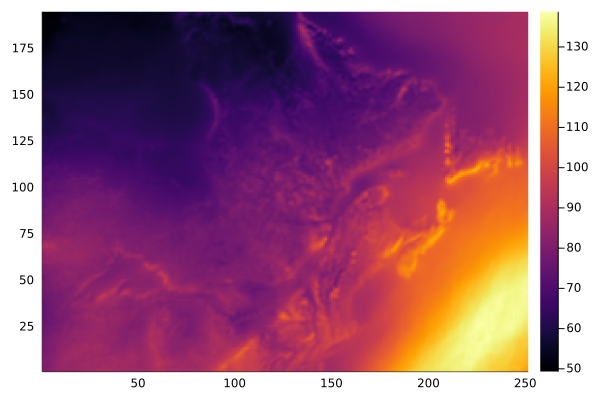

In [33]:
T = 20

μ = dropdims(C[:,["μ[$i]" for i=1:m],1].value, dims=3)
σ = dropdims(C[:,["σ[$i]" for i=1:m],1].value, dims=3)
ξ = dropdims(C[:,"ξ",1].value, dims=3)

pd = GeneralizedExtremeValue.(μ, σ, ξ)

q = mean(quantile.(pd, 1-1/T), dims=1)

Plots.heatmap(reshape(q,m₁,m₂))

In [34]:
# write("Results/sim1.jls", pd)
# sim1 = read("sim1.jls", ModelChains)

In [35]:
# quantile(C.value[:,end,1],[.025 .975])